tensor([[5., 7., 9.]]) 
 tensor([[ 6.],
        [15.]])
X exp is:  tensor([[0.5299, 5.6922, 2.0695, 4.7874, 0.6565],
        [0.1430, 1.0625, 1.9642, 0.9310, 0.8866]])
partition is:  tensor([[13.7355],
        [ 4.9872]])
tensor([0.1000, 0.5000])
tensor([2.3026, 0.6931])
0.5
X exp is:  tensor([[0.9646, 0.9903, 1.0945,  ..., 0.9691, 0.8472, 1.1354],
        [1.1127, 0.9778, 1.1730,  ..., 1.1002, 0.6869, 1.1080],
        [1.0725, 1.0337, 1.2371,  ..., 0.9898, 0.8258, 1.0506],
        ...,
        [1.1188, 0.9089, 1.0964,  ..., 1.0670, 0.9851, 1.1313],
        [0.8961, 1.0024, 1.1700,  ..., 1.0575, 1.0273, 1.1291],
        [1.0419, 0.9539, 1.2549,  ..., 1.0624, 0.7847, 1.0696]],
       grad_fn=<ExpBackward0>)
partition is:  tensor([[ 9.7342],
        [ 9.6369],
        [10.1649],
        [10.0478],
        [ 9.8338],
        [10.3504],
        [ 9.9108],
        [ 9.6431],
        [10.1197],
        [ 9.9958],
        [ 9.5231],
        [10.1379],
        [10.0177],
        [10.3326],
   

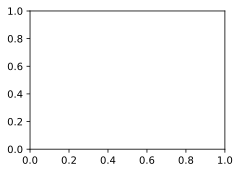

In [11]:
import torch
import torchvision
from torch.utils import data
from torchvision import transforms
from d2l import torch as d2l

d2l.use_svg_display()


def get_dataloader_workers():
    """使用4个进程来读取数据"""
    return 4

def load_data_fashion_mmist(batch_size, resize=None):
    """下载Fashion-Mnist数据集,然后将其加载到内存中"""
    trans = transforms.ToTensor()
    if resize:
        trans.insert(0, transforms.Resize(resize))
    mnist_train = torchvision.datasets.FashionMNIST(
        root = "./src", train=True, transform=trans,download=True
    )
    mnist_test = torchvision.datasets.FashionMNIST(
        root = "./src", train=False, transform=trans,download=True
    )
    return (data.DataLoader(mnist_train, batch_size, shuffle=True, num_workers=get_dataloader_workers()), 
            data.DataLoader(mnist_test, batch_size, shuffle=True, num_workers=get_dataloader_workers()))

# 假定的数据
# train_test = 0
# # 看看读数据的时间
# timer = d2l.Timer()
# for X, y in train_test:
#     continue
# f'{timer.stop():.2f} sec'


# softmax回归从零实现
import torch
from IPython import display
from d2l import torch as d2l

batch_size = 256
train_iter, test_iter = d2l.load_data_fashion_mnist(batch_size)

num_inputs = 784
num_outputs = 10

W = torch.normal(0, 0.01, size = (num_inputs, num_outputs), requires_grad=True)
b = torch.zeros(num_outputs, requires_grad=True)

# 看sum函数axis不同对应的效果
X = torch.tensor([[1.0, 2.0, 3.0], [4.0, 5.0, 6.0]])    # X就是置信度
print(X.sum(0, keepdim=True), '\n', X.sum(1, keepdim=True))

def softmax(X):
    X_exp = torch.exp(X) 
    print('X exp is: ',X_exp)
    partition = X_exp.sum(1, keepdim=True)  # 对于矩阵的sum,是对每一行做的
    print('partition is: ', partition)
    return X_exp / partition                # 这里有广播机制,除是对应除

# 做概率和的验证
X = torch.normal(0, 1, (2, 5))
X_prob = softmax(X)
X_prob, X_prob.sum(1)

# softmax回归模型
def net(X):
    global W
    return softmax(torch.matmul(X.reshape((-1, W.shape[0])), W) + b)

# 拿预测值的例子
y = torch.tensor([0, 2])
y_hat = torch.tensor([[0.1, 0.3, 0.6], [0.3, 0.2, 0.5]])
print(y_hat[[0, 1], y])

# 交叉熵损失函数
def cross_entropy(y_hat, y):
    return -torch.log(y_hat[range(len(y_hat)), y])

print(cross_entropy(y_hat, y))

def accuracy(y_hat, y):
    """计算预测正确的数量"""
    if len(y_hat.shape) > 1 and y_hat.shape[1] > 1:
        y_hat = y_hat.argmax(axis = 1)
    cmp = y_hat.type(y.dtype) == y
    return float(cmp.type(y.dtype).sum())

print(accuracy(y_hat, y) / len(y))


def evaluate_accuracy(net, data_iter):
    """计算在指定数据集上模型的精度"""
    if isinstance(net, torch.nn.Module):
        net.eval()  # 模型设置为评估模式
    metric = Accumulator(2)     #这是一个累加器 
    for X, y in data_iter:
        metric.add(accuracy(net(X), y), y.numel())
    return metric[0] / metric[1]    # 分类正确的样本数和总样本数

class Accumulator:
    """在n个变量上累加"""
    def __init__(self, n):
        self.data = [0.0] * n
    
    def add(self, *args):
        self.data = [a + float(b) for a, b in zip(self.data, args)]

    def reset(self):
        self.data = [0.0] * len(self.data)

    def __getitem__(self, idx):
        return self.data[idx]

print(evaluate_accuracy(net, test_iter))


def train_epoch_ch3(net, train_iter, loss, updater):
    if isinstance(net, torch.nn.Module):
        net.train()
    metric = Accumulator(3)
    for X, y in train_iter:
        y_hat = net(X)
        l = loss(y_hat, y)
        if isinstance(updater, torch.optim.Optimizer): # 后一个是pytorch的updater
            updater.zero_grad()
            l.backward()
            updater.step()  # 参数自更新
            metric.add(float(l) * len(y), accuracy(y_hat, y), y.size().numel())
        else:   #如果updater是我们自己实现的话
            l.sum().backward()
            updater(X.shape[0])
            metric.add(float(l.sum()), accuracy(y_hat, y), y.numel())
    return metric[0] / metric[2], metric[1] / metric[2]

# 损失函数小动画函数
class Animator:
    def __init__(self, xlabel=None, ylabel=None, legend=None, xlim=None, ylim=None, xscale='linear', yscale='linear', fmts=('-', 'm--', 'g-.', 'r:'), nrows=1, ncols=1, figsize=(3.5, 2.5)):
        if legend is None:
            legend = []

        d2l.use_svg_display()
        self.fig, self.axes = d2l.plt.subplots(nrows, ncols, figsize=figsize)
        if nrows * ncols == 1:
            self.axes = [self.axes,]
        self.config_axes = lambda: d2l.set_axes(self.axes[0], xlabel, ylabel, xlim, ylim, xscale, yscale, legend)
        self.X, self.Y, self.fmts = None, None, fmts

    def add(self, x, y):
        if not hasattr(y, "__len__"):
            y = [y]
        n = len(y)

# 训练函数
def train_ch3(net, train_iter, test_iter, loss, num_epochs, updater):
    animator = Animator(xlabel='epoch', xlim=[1, num_epochs], ylim=[0.3,num_epochs], legend=['train loss', 'train acc', 'test acc'])
    for epoch in range(num_epochs):
        train_metrics = train_epoch_ch3(net, train_iter, loss, updater)
        test_acc = evaluate_accuracy(net, test_iter)
        animator.add(epoch + 1, train_metrics + (test_acc,))
    train_loss, train_acc = train_metrics

lr = 0.1
def updater(batch_size):
    return d2l.sgd([W, b], lr, batch_size)

num_epochs = 10
train_ch3(net, train_iter, test_iter, cross_entropy, num_epochs, updater)





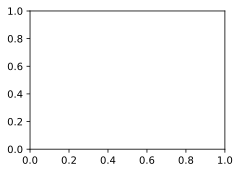

In [10]:
# softmax回归模型简洁实现
import torch
from torch import nn
from d2l import torch as d2l

batch_size = 256
train_iter, test_iter = d2l.load_data_fashion_mnist(batch_size)

# pytorch 不会隐式地调整输入的形状
# 因此,需要定义一个展平层(flatten) 在线性层前调整网络输入的形状
net = nn.Sequential(nn.Flatten(), nn.Linear(784, 10))   #2D

def init_weights(m):
    if type(m) == nn.Linear:
        nn.init.normal_(m.weight, std=0.01) # 方差0.01

net.apply(init_weights) # 这是初始化

loss = nn.CrossEntropyLoss()

trainer = torch.optim.SGD(net.parameters(), lr = 0.1)

def evaluate_accuracy(net, data_iter):
    """计算在指定数据集上模型的精度"""
    if isinstance(net, torch.nn.Module):
        net.eval()  # 模型设置为评估模式
    metric = Accumulator(2)     #这是一个累加器 
    for X, y in data_iter:
        metric.add(accuracy(net(X), y), y.numel())
    return metric[0] / metric[1]    # 分类正确的样本数和总样本数

def accuracy(y_hat, y):
    """计算预测正确的数量"""
    if len(y_hat.shape) > 1 and y_hat.shape[1] > 1:
        y_hat = y_hat.argmax(axis = 1)
    cmp = y_hat.type(y.dtype) == y
    return float(cmp.type(y.dtype).sum())

class Accumulator:
    """在n个变量上累加"""
    def __init__(self, n):
        self.data = [0.0] * n
    
    def add(self, *args):
        self.data = [a + float(b) for a, b in zip(self.data, args)]

    def reset(self):
        self.data = [0.0] * len(self.data)

    def __getitem__(self, idx):
        return self.data[idx]


def train_epoch_ch3(net, train_iter, loss, updater):
    if isinstance(net, torch.nn.Module):
        net.train()
    metric = Accumulator(3)
    for X, y in train_iter:
        y_hat = net(X)
        l = loss(y_hat, y)
        if isinstance(updater, torch.optim.Optimizer): # 后一个是pytorch的updater
            updater.zero_grad()
            l.backward()
            updater.step()  # 参数自更新
            metric.add(float(l) * len(y), accuracy(y_hat, y), y.size().numel())
        else:   #如果updater是我们自己实现的话
            l.sum().backward()
            updater(X.shape[0])
            metric.add(float(l.sum()), accuracy(y_hat, y), y.numel())
    return metric[0] / metric[2], metric[1] / metric[2]

# 损失函数小动画函数
class Animator:
    def __init__(self, xlabel=None, ylabel=None, legend=None, xlim=None, ylim=None, xscale='linear', yscale='linear', fmts=('-', 'm--', 'g-.', 'r:'), nrows=1, ncols=1, figsize=(3.5, 2.5)):
        if legend is None:
            legend = []

        d2l.use_svg_display()
        self.fig, self.axes = d2l.plt.subplots(nrows, ncols, figsize=figsize)
        if nrows * ncols == 1:
            self.axes = [self.axes,]
        self.config_axes = lambda: d2l.set_axes(self.axes[0], xlabel, ylabel, xlim, ylim, xscale, yscale, legend)
        self.X, self.Y, self.fmts = None, None, fmts

    def add(self, x, y):
        if not hasattr(y, "__len__"):
            y = [y]
        n = len(y)

# 训练函数
def train_ch3(net, train_iter, test_iter, loss, num_epochs, updater):
    animator = Animator(xlabel='epoch', xlim=[1, num_epochs], ylim=[0.3,num_epochs], legend=['train loss', 'train acc', 'test acc'])
    for epoch in range(num_epochs):
        train_metrics = train_epoch_ch3(net, train_iter, loss, updater)
        test_acc = evaluate_accuracy(net, test_iter)
        animator.add(epoch + 1, train_metrics + (test_acc,))
    train_loss, train_acc = train_metrics


num_epochs = 10
train_ch3(net, train_iter, test_iter, loss, num_epochs, trainer)